In [91]:
import numpy as np
import pandas as pd
from pandas.tseries.holiday import USFederalHolidayCalendar as calendar
import holidays

from prophet import Prophet
from sklearn.metrics import mean_squared_error, mean_absolute_error

import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio

# Data
The data we will be using is hourly power consumption data from PJM. Energy consumtion has some unique charachteristics. It will be interesting to see how prophet picks them up.

Pulling the PJM East which has data from 2002-2018 for the entire east region.

import the data thanks to the following link : https://full-stack-bigdata-datasets.s3.eu-west-3.amazonaws.com/Machine+Learning+Supervis%C3%A9/time_series/PJME_hourly.csv`` make sure to use the arguments index_col=[0], parse_dates=[0]``` and remove all dates previous to january the first 2008

In [92]:
# Lire le fichier CSV à partir de l'URL, en définissant la première colonne comme index et en la parsant comme des dates
pjme = pd.read_csv(
    'https://full-stack-bigdata-datasets.s3.eu-west-3.amazonaws.com/Machine+Learning+Supervis%C3%A9/time_series/PJME_hourly.csv',
    index_col=[0],  # La première colonne est utilisée comme index
    parse_dates=[0]  # La première colonne est interprétée comme des dates
)

# Basic statistics and dataset overview
print(f"Number of rows: {pjme.shape[0]}")
print(f"Number of columns: {pjme.shape[1]}")
print()

# Filtrer les données à partir du 1er janvier 2008
start_date = '01-Jan-2008'
pjme = pjme.loc[pjme.index >= start_date]

# Supprimer les indices dupliqués
pjme = pjme[~pjme.index.duplicated()]

# Basic statistics and dataset overview
print(f"Number of rows: {pjme.shape[0]}")
print(f"Number of columns: {pjme.shape[1]}")


# Afficher les premières lignes du DataFrame après le filtrage et la suppression des doublons
pjme.head()

Number of rows: 145366
Number of columns: 1

Number of rows: 92791
Number of columns: 1


,PJME_MW
Datetime,
2008-01-01 00:00:00,30998.0
2008-12-31 01:00:00,28937.0
2008-12-31 02:00:00,27714.0
2008-12-31 03:00:00,27120.0
2008-12-31 04:00:00,26995.0


Plot the time series

In [93]:
# Création de la figure
fig = go.Figure()

# Ajout de la ligne "Open_AAPL"
fig.add_trace(go.Scatter(
    x=pjme.index,
    y=pjme["PJME_MW"],
    mode="lines",
    name="dataset",
    line=dict(color="blue", width=2)
))

# Personnalisation du graphique
fig.update_layout(
    title="Energy Consumption _ PJM",
    xaxis_title="Date",
    yaxis_title="PJM",
    template="plotly_white"
)

# Affichage
fig.show()

# EDA

Create this collection of new variables :

date equal to the index

hour equal to the hour of the day

dayofweek

quarter

month

year

dayofyear

dayofmonth

weekofyear

Create an object X containing the above variables and y containing the time series

In [94]:
def create_features(df, label=None):
    """
    Creates time series features from datetime index.
    """
    df = df.copy()  # Crée une copie du DataFrame pour éviter de modifier l'original
    df['date'] = df.index
    
    # Extraire les différentes caractéristiques temporelles
    features = {
        'hour': df['date'].dt.hour,
        'dayofweek': df['date'].dt.dayofweek,
        'quarter': df['date'].dt.quarter,
        'month': df['date'].dt.month,
        'year': df['date'].dt.year,
        'dayofyear': df['date'].dt.dayofyear,
        'dayofmonth': df['date'].dt.day,
        'weekofyear': df['date'].dt.isocalendar().week
    }
    
    # Ajouter ces caractéristiques au DataFrame
    df = df.assign(**features)
    
    # Sélectionner les colonnes de caractéristiques
    X = df[['hour', 'dayofweek', 'quarter', 'month', 'year', 'dayofyear', 'dayofmonth', 'weekofyear']]
    
    # Si un label est fourni, retourner X et y
    if label:
        y = df[label]
        return X, y
    
    return X

# Application
X, y = create_features(pjme, label='PJME_MW')

# Combiner les caractéristiques et la cible en un seul DataFrame
features_and_target = pd.concat([X, y], axis=1)

Create an object features_and_target containing both and display the first few lines

In [95]:
features_and_target.head()

,hour,dayofweek,quarter,month,year,dayofyear,dayofmonth,weekofyear,PJME_MW
Datetime,,,,,,,,,
2008-01-01 00:00:00,0,1,1,1,2008,1,1,1,30998.0
2008-12-31 01:00:00,1,2,4,12,2008,366,31,1,28937.0
2008-12-31 02:00:00,2,2,4,12,2008,366,31,1,27714.0
2008-12-31 03:00:00,3,2,4,12,2008,366,31,1,27120.0
2008-12-31 04:00:00,4,2,4,12,2008,366,31,1,26995.0


# Plotting the Features to see trends

Plot the time series against hour, dayofweek, weekofyear, year

In [96]:
# Créer un graphique de dispersion pour chaque caractéristique par rapport à 'PJME_MW'
features = ['hour', 'dayofweek', 'weekofyear', 'year']

for feature in features:
    fig = px.scatter(features_and_target, x=feature, y='PJME_MW', color='hour' if feature != 'hour' else None)
    fig.show()

# Train/Test Split

Cut off the data after 2015 to use as our validation set. We will train on earlier data.

In [97]:
# Définir la date de séparation (s'assurer que c'est au format datetime)
split_date = pd.to_datetime('01-Jan-2015')

# Créer l'ensemble d'entraînement (données jusqu'à et y compris la date de séparation)
pjme_train = pjme.loc[pjme.index <= split_date].copy()

# Créer l'ensemble de test (données après la date de séparation)
pjme_test = pjme.loc[pjme.index > split_date].copy()

plot the series with different colors for the train and test set to visualize the separation.

In [98]:
# Créer un graphique de ligne pour les données d'entraînement
fig = go.Figure()

# Ajouter la trace pour l'ensemble d'entraînement
fig.add_trace(go.Scatter(x=pjme_train.index, y=pjme_train["PJME_MW"], mode='lines', name='Entraînement'))

# Ajouter la trace pour l'ensemble de test avec une couleur différente
fig.add_trace(go.Scatter(x=pjme_test.index, y=pjme_test["PJME_MW"], mode='lines', name='Test', line=dict(color="#4BE8E0")))

# Mettre à jour le titre et les axes
fig.update_layout(
    title="Évolution de PJME_MW",
    xaxis_title="Date",
    yaxis_title="PJME_MW",
    template="plotly_white"
)

# Afficher la figure
fig.show()

# Simple Prophet Model

In pjme_train rename the Datetime variable "ds" and PJME_MW "y" to fit into the Prophet framework

In [99]:
# Préparer les données pour Prophet
pjme_train_prophet = pd.DataFrame({
    "ds": pjme_train.index,
    "y": pjme_train["PJME_MW"].reset_index(drop=True)
})

# Suppression du fuseau horaire
pjme_train_prophet["ds"] = pjme_train_prophet["ds"].dt.tz_localize(None)

pjme_train_prophet.head()

,ds,y
0,2008-01-01 00:00:00,30998.0
1,2008-12-31 01:00:00,28937.0
2,2008-12-31 02:00:00,27714.0
3,2008-12-31 03:00:00,27120.0
4,2008-12-31 04:00:00,26995.0


Create an instance of the Prophet model and fit it on the train data.

In [100]:
# Création et ajustement du modèle Prophet
model = Prophet()
model.fit(pjme_train_prophet)

20:39:10 - cmdstanpy - INFO - Chain [1] start processing
20:39:25 - cmdstanpy - INFO - Chain [1] done processing


Make predictions with your trained default prophet model on the test set

In [101]:
# Préparer les données pour Prophet (en supposant que l'index de pjme_test soit un DatetimeIndex)
pjme_test_prophet = pd.DataFrame({
    "ds": pjme_test.index
})

# Effectuer la prédiction avec le modèle
pjme_test_fcst = model.predict(df=pjme_test_prophet)

In [102]:
pjme_test_fcst.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2015-01-01 01:00:00,30844.042544,25781.369362,34343.116115,30844.042544,30844.042544,-1064.041182,-1064.041182,-1064.041182,-4352.147809,...,1236.812329,1236.812329,1236.812329,2051.294298,2051.294298,2051.294298,0.0,0.0,0.0,29780.001362
1,2015-01-01 02:00:00,30843.921423,23827.081718,32585.724252,30843.921423,30843.921423,-2539.118165,-2539.118165,-2539.118165,-5821.667595,...,1228.673667,1228.673667,1228.673667,2053.875762,2053.875762,2053.875762,0.0,0.0,0.0,28304.803258
2,2015-01-01 03:00:00,30843.800301,23225.750260,31800.288826,30843.800301,30843.800301,-3394.755447,-3394.755447,-3394.755447,-6670.440581,...,1219.202189,1219.202189,1219.202189,2056.482945,2056.482945,2056.482945,0.0,0.0,0.0,27449.044854
3,2015-01-01 04:00:00,30843.679179,22907.935385,31629.139834,30843.679179,30843.679179,-3520.027570,-3520.027570,-3520.027570,-6787.650475,...,1208.507057,1208.507057,1208.507057,2059.115848,2059.115848,2059.115848,0.0,0.0,0.0,27323.651609
4,2015-01-01 05:00:00,30843.558057,23827.965690,32569.541120,30843.558057,30843.558057,-2829.064707,-2829.064707,-2829.064707,-6087.548484,...,1196.709302,1196.709302,1196.709302,2061.774475,2061.774475,2061.774475,0.0,0.0,0.0,28014.493350


Plot the trend, the yearly seasonnality, the weekly seasonnality, and the daily seasonnality.

/var/folders/dm/k1smy03547zg0plbdy1r1l380000gn/T/ipykernel_56659/3976294185.py:3: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



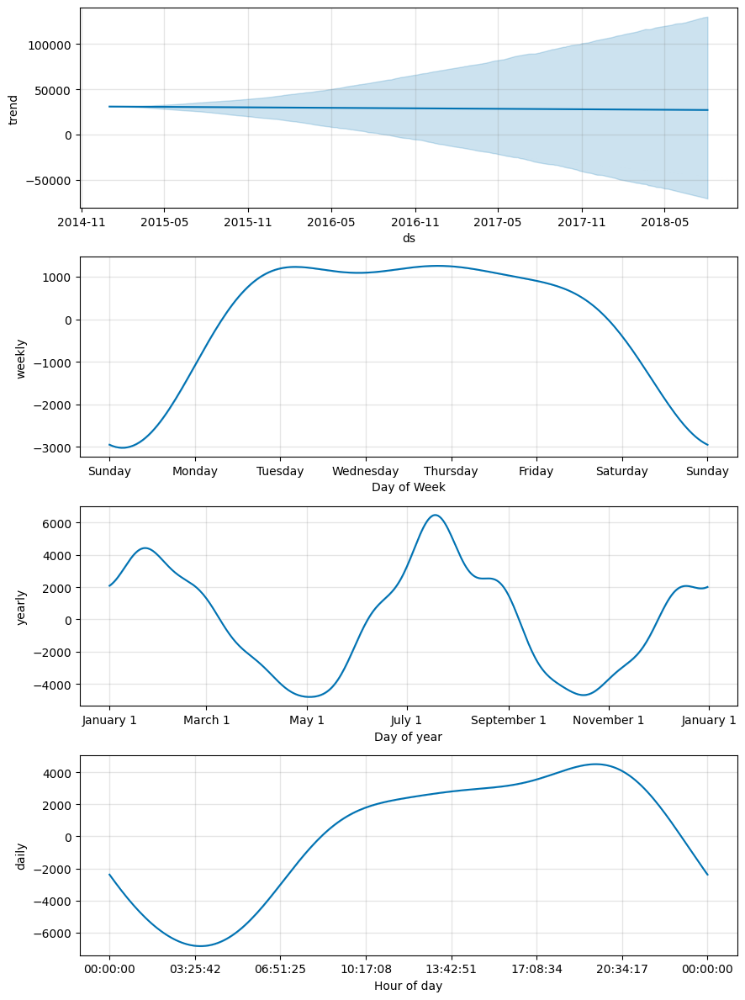

In [103]:
# Composants de la prévision
fig = model.plot_components(pjme_test_fcst)
fig.show()

# Compare Forecast to Actuals

Plot the forcasts against the actual values in the test set.

In [104]:
# Créer la figure de base avec les données de test
fig = go.Figure()

# Ajouter la trace de dispersion pour 'PJME_MW'
fig.add_trace(go.Scatter(x=pjme_test.index, y=pjme_test['PJME_MW'], mode='markers', name='Données réelles'))

# Ajouter la trace de ligne pour les prévisions avec couleur spécifique
fig.add_trace(go.Scatter(x=pjme_test_fcst['ds'], y=pjme_test_fcst['yhat'], mode='lines', name='Prévisions', line=dict(color="#4BE8E0")))

# Mettre à jour les titres et labels des axes
fig.update_layout(
    title="Données réelles et prévisions de PJME_MW",
    xaxis_title="Date",
    yaxis_title="PJME_MW",
    template="plotly_white"
)

# Afficher la figure
fig.show()

# Look at first month of predictions

Compare in a graph predictions for the first month against reality.

In [105]:
# Créer un masque pour filtrer les données de test entre le 1er et le 2 janvier 2015
mask = (pjme_test.index >= '01-01-2015') & (pjme_test.index < '02-01-2015')

# Filtrer les données pour le scatter plot (PJME_MW) en fonction du masque
filtered_data = pjme_test.loc[mask, :]

# Créer la figure
fig = go.Figure()

# Ajouter la trace pour les données réelles avec un scatter plot
fig.add_trace(go.Scatter(x=filtered_data.index, y=filtered_data['PJME_MW'], mode='markers', name='Données réelles'))

# Ajouter la trace pour les prévisions avec une ligne
forecast_data = pjme_test_fcst.loc[0:30*24, :]
fig.add_trace(go.Scatter(x=forecast_data['ds'], y=forecast_data['yhat'], mode='lines', name='Prévisions', line=dict(color="#4BE8E0")))

# Mettre à jour les titres et labels des axes
fig.update_layout(
    title="Données réelles et prévisions de PJME_MW (01-01-2015 à 02-01-2015)",
    xaxis_title="Date",
    yaxis_title="PJME_MW",
    template="plotly_white",
    width=1200
)

# Afficher la figure
fig.show()

# Single Week of Predictions

plot the first week of data against the model's predictions

In [106]:
# Créer un masque pour filtrer les données entre le 1er janvier et le 1er août 2015
mask = (pjme_test.index >= '01-01-2015') & (pjme_test.index < '01-08-2015')

# Filtrer les données pour le scatter plot
filtered_data = pjme_test.loc[mask, :]

# Créer la figure
fig = go.Figure()

# Ajouter la trace pour les données réelles avec un scatter plot
fig.add_trace(go.Scatter(x=filtered_data.index, y=filtered_data['PJME_MW'], mode='markers', name='Données réelles'))

# Ajouter la trace pour les prévisions avec une ligne
forecast_data = pjme_test_fcst.loc[0:8*24, :]  # Limiter les prévisions à 8 jours (8*24 heures)
fig.add_trace(go.Scatter(x=forecast_data['ds'], y=forecast_data['yhat'], mode='lines', name='Prévisions', line=dict(color="#4BE8E0")))

# Mettre à jour les titres et labels des axes
fig.update_layout(
    title="Données réelles et prévisions de PJME_MW (01-01-2015 à 01-08-2015)",
    xaxis_title="Date",
    yaxis_title="PJME_MW",
    template="plotly_white",
    width=1200
)

# Afficher la figure
fig.show()

Calculate the MSE, the MAE and the MAPE (mean obsolute percentage error) for this model over the test dataset

erreurs courantes dans les modèles de régression, à savoir l’erreur quadratique moyenne (MSE), l’erreur absolue moyenne (MAE) et l’erreur absolue en pourcentage moyenne (MAPE).

In [107]:
# Fonction pour afficher les erreurs
def print_error_metrics(y_true, y_pred):
    # Calcul de MSE
    mse = mean_squared_error(y_true, y_pred)
    print(f"The MSE on the test set is: {mse:.4f}")
    
    # Calcul de MAE
    mae = mean_absolute_error(y_true, y_pred)
    print(f"The MAE on the test set is: {mae:.4f}")
    
    # Calcul de MAPE
    def mean_absolute_percentage_error(y_true, y_pred): 
        """Calculates MAPE given y_true and y_pred"""
        y_true, y_pred = np.array(y_true), np.array(y_pred)
        return np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    
    mape = mean_absolute_percentage_error(y_true, y_pred)
    print(f"The MAPE on the test set is: {mape:.4f}%")

# Appeler la fonction pour afficher les erreurs sur les données de test
print_error_metrics(pjme_test['PJME_MW'], pjme_test_fcst['yhat'])

The MSE on the test set is: 46491343.0430
The MAE on the test set is: 5328.9011
The MAPE on the test set is: 16.5043%


# Adding Holidays

Next we will see if adding holiday indicators will help the accuracy of the model. Prophet comes with a Holiday Effects parameter that can be provided to the model prior to training.

We will use the built in pandas USFederalHolidayCalendar to pull the list of holidays

Create a test_holidays object containing the us federal holidays for the considered test period and an object train_holidays for the considered train period.

In [110]:
# Créer l'objet calendrier pour les jours fériés fédéraux aux États-Unis
cal = calendar()

# Récupérer les jours fériés pour l'ensemble d'entraînement et de test
train_holidays = cal.holidays(start=pjme_train.index.min(), end=pjme_train.index.max())
test_holidays = cal.holidays(start=pjme_test.index.min(), end=pjme_test.index.max())

Create a DataFrame contaning all holidays over the observed period with a ds column with the dates and a holiday column with the holidays and convert ds column to datetime format.

In [111]:
# Créer une nouvelle colonne 'date' dans le DataFrame 'pjme' avec la partie date uniquement
pjme['date'] = pjme.index.date  # Extraire uniquement la date (sans l'heure)

# Vérifier si chaque date est un jour férié
pjme['is_holiday'] = pjme['date'].isin(train_holidays.date)

# Créer le DataFrame des jours fériés
holiday_df = pjme.loc[pjme['is_holiday']] \
    .reset_index() \
    .rename(columns={'Datetime': 'ds'})  # Renommer 'Datetime' en 'ds' pour Prophet

# Ajouter la colonne 'holiday' avec la valeur 'USFederalHoliday'
holiday_df['holiday'] = 'USFederalHoliday'

# Supprimer les colonnes inutiles
holiday_df = holiday_df.drop(['PJME_MW', 'date', 'is_holiday'], axis=1)

# Afficher les premières lignes du DataFrame des jours fériés
holiday_df.head()

,ds,holiday
0,2008-01-01 00:00:00,USFederalHoliday
1,2009-01-01 00:00:00,USFederalHoliday
2,2008-12-25 01:00:00,USFederalHoliday
3,2008-12-25 02:00:00,USFederalHoliday
4,2008-12-25 03:00:00,USFederalHoliday


In [112]:
# conversion de la colonne ds du df holiday_df en objet datetime

holiday_df['ds'] = pd.to_datetime(holiday_df['ds'])

Create an instance of the Prophet model with holidays = holiday_df the DataFrame we have just created, and train that model on the training set.

In [113]:
# Configurer et entraîner le modèle avec des jours fériés
model_with_holidays = Prophet(holidays=holiday_df)
model_with_holidays.fit(pjme_train_prophet)

# Afficher un message pour confirmer que le modèle a été entraîné
print("Model with holidays trained successfully.")

20:43:29 - cmdstanpy - INFO - Chain [1] start processing
20:43:45 - cmdstanpy - INFO - Chain [1] done processing


Model with holidays trained successfully.


# Predict With Holidays

Make predictions for the test set with the holiday model

In [114]:
# Effectuer les prédictions
pjme_test_fcst_with_hols = model_with_holidays.predict(df=pjme_test_prophet)

# Plot Holiday 

Plot the different components of the holiday model

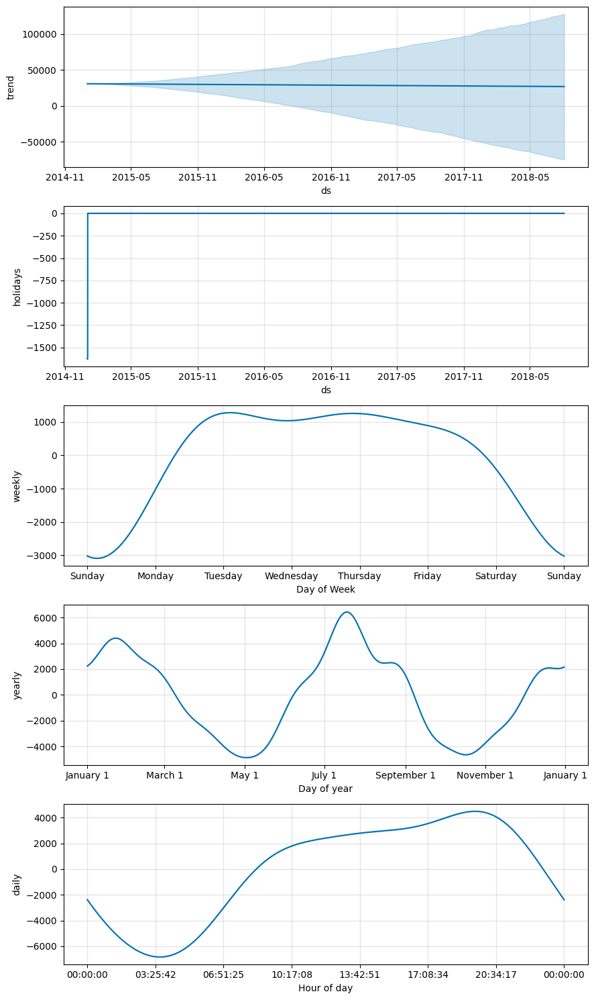

In [115]:
# Composants de la prévision
fig2 = model_with_holidays.plot_components(pjme_test_fcst_with_hols)
fig.show()

# Error Metrics with Holidays Added

Calculate the MSE, MAE and MAPE for the holiday model on the test set.

In [116]:
# Fonction pour afficher les erreurs
def print_error_metrics(y_true, y_pred):
    # Calcul de MSE
    mse = mean_squared_error(y_true, y_pred)
    print(f"The MSE on the test set is: {mse:.4f}")
    
    # Calcul de MAE
    mae = mean_absolute_error(y_true, y_pred)
    print(f"The MAE on the test set is: {mae:.4f}")
    
    # Calcul de MAPE
    def mean_absolute_percentage_error(y_true, y_pred): 
        """Calculates MAPE given y_true and y_pred"""
        y_true, y_pred = np.array(y_true), np.array(y_pred)
        return np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    
    mape = mean_absolute_percentage_error(y_true, y_pred)
    print(f"The MAPE on the test set is: {mape:.4f}%")

# Appeler la fonction pour afficher les erreurs sur les données de test
print_error_metrics(pjme_test['PJME_MW'], pjme_test_fcst_with_hols['yhat'])

The MSE on the test set is: 46633724.4156
The MAE on the test set is: 5338.3064
The MAPE on the test set is: 16.5369%
